In [1]:
import numpy as np 
import pandas as pd
import matplotlib.pyplot as plt
%matplotlib inline
import seaborn as sns

In [2]:
df = pd.read_csv("Dataset.csv")
df.head()

,Restaurant ID,Restaurant Name,Country Code,City,Address,Locality,Locality Verbose,Longitude,Latitude,Cuisines,...,Currency,Has Table booking,Has Online delivery,Is delivering now,Switch to order menu,Price range,Aggregate rating,Rating color,Rating text,Votes
0,6317637,Le Petit Souffle,162,Makati City,"Third Floor, Century City Mall, Kalayaan Avenu...","Century City Mall, Poblacion, Makati City","Century City Mall, Poblacion, Makati City, Mak...",121.027535,14.565443,"French, Japanese, Desserts",...,Botswana Pula(P),Yes,No,No,No,3,4.8,Dark Green,Excellent,314
1,6304287,Izakaya Kikufuji,162,Makati City,"Little Tokyo, 2277 Chino Roces Avenue, Legaspi...","Little Tokyo, Legaspi Village, Makati City","Little Tokyo, Legaspi Village, Makati City, Ma...",121.014101,14.553708,Japanese,...,Botswana Pula(P),Yes,No,No,No,3,4.5,Dark Green,Excellent,591
2,6300002,Heat - Edsa Shangri-La,162,Mandaluyong City,"Edsa Shangri-La, 1 Garden Way, Ortigas, Mandal...","Edsa Shangri-La, Ortigas, Mandaluyong City","Edsa Shangri-La, Ortigas, Mandaluyong City, Ma...",121.056831,14.581404,"Seafood, Asian, Filipino, Indian",...,Botswana Pula(P),Yes,No,No,No,4,4.4,Green,Very Good,270
3,6318506,Ooma,162,Mandaluyong City,"Third Floor, Mega Fashion Hall, SM Megamall, O...","SM Megamall, Ortigas, Mandaluyong City","SM Megamall, Ortigas, Mandaluyong City, Mandal...",121.056475,14.585318,"Japanese, Sushi",...,Botswana Pula(P),No,No,No,No,4,4.9,Dark Green,Excellent,365
4,6314302,Sambo Kojin,162,Mandaluyong City,"Third Floor, Mega Atrium, SM Megamall, Ortigas...","SM Megamall, Ortigas, Mandaluyong City","SM Megamall, Ortigas, Mandaluyong City, Mandal...",121.057508,14.584450,"Japanese, Korean",...,Botswana Pula(P),Yes,No,No,No,4,4.8,Dark Green,Excellent,229


In [3]:
df.drop(['Switch to order menu'],axis=1,inplace=True)

# Level 2 
## Task 1  Restaurant Ratings

### Q1. Analyze the distribution of aggregate ratings and determine the most common rating range?

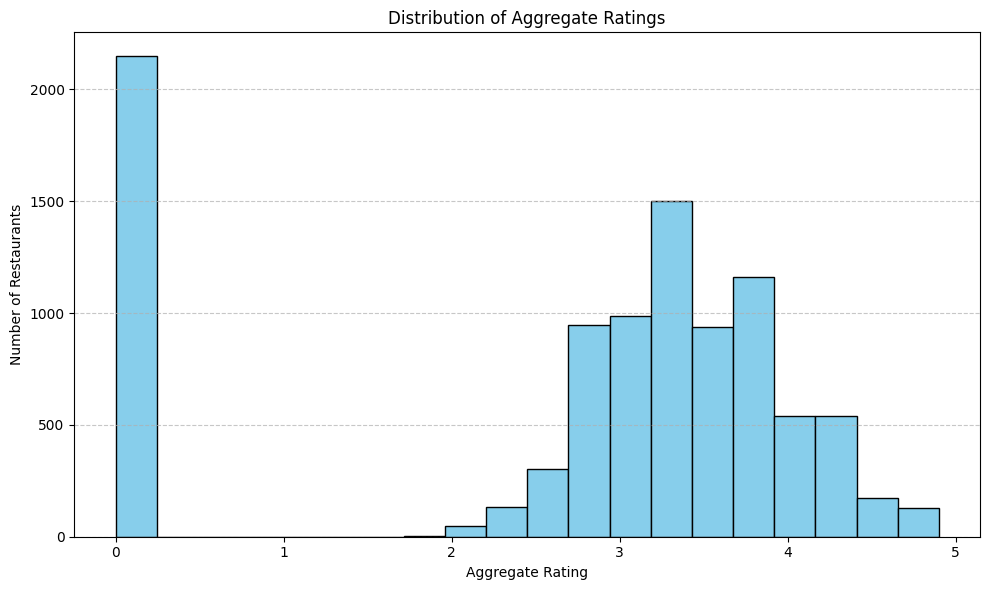

In [4]:
# Plotting a histogram of aggregate ratings
plt.figure(figsize=(10, 6))
plt.hist(df['Aggregate rating'], bins=20, color='skyblue', edgecolor='black')
plt.xlabel('Aggregate Rating')
plt.ylabel('Number of Restaurants')
plt.title('Distribution of Aggregate Ratings')
plt.grid(axis='y', linestyle='--', alpha=0.7)
plt.tight_layout()
plt.show()

In [5]:
# Determine the most common rating range
rating_counts = df['Aggregate rating'].value_counts()
most_common_rating = rating_counts.idxmax()

print(f"The most common rating range is around {most_common_rating:.2f}.")

The most common rating range is around 0.00.


### Q2. Calculate the average number of votes received by restaurants?

In [6]:
# Calculate the average number of votes received by restaurants
average_votes = df['Votes'].mean()

print(f"The average number of votes received by restaurants is: {average_votes:.2f}")

The average number of votes received by restaurants is: 156.91


# Level 2
## Task 2  Cuisine Combination

### Q1.  Identify the most common combinations of cuisines in the dataset?

In [7]:
# Drop rows where 'Cuisines' column is NaN
df = df.dropna(subset=['Cuisines'])

In [8]:
# Split the cuisines into separate columns
cuisines_split = df['Cuisines'].str.split(', ')

# Create a list to store all cuisine combinations
all_cuisines = []

# Iterate over each row and append the cuisine combinations to the list
for cuisines in cuisines_split:
    all_cuisines.extend(cuisines)

In [9]:
# Count the occurrences of each cuisine combination
cuisine_counts = pd.Series(all_cuisines).value_counts()

# Display the top 10 most common cuisine combinations
print("Top 15 Most Common Cuisine Combinations:")
print(cuisine_counts.head(15))

Top 15 Most Common Cuisine Combinations:
North Indian    3960
Chinese         2735
Fast Food       1986
Mughlai          995
Italian          764
Bakery           745
Continental      736
Cafe             703
Desserts         653
South Indian     636
Street Food      562
American         390
Pizza            381
Mithai           380
Burger           251
Name: count, dtype: int64


### Q2. Determine if certain cuisine combinations tend to have higher ratings?

In [10]:
cuisine_df = df.explode('Cuisines').reset_index(drop=True)

In [11]:
# Split the "Cuisines" column and create a new dataframe with separate cuisine entries
def split_cuisines(row):
  cuisines = row['Cuisines'].split(',')
  return pd.DataFrame({'Restaurant ID': row['Restaurant ID'] for _ in cuisines}, index=cuisines)

cuisine_df = df.explode('Cuisines').reset_index(drop=True)

In [12]:
# Group by cuisine and calculate average rating
cuisine_avg_rating = cuisine_df.groupby('Cuisines')['Aggregate rating'].mean()

# Sort by average rating (optional)
cuisine_avg_rating = cuisine_avg_rating.sort_values(ascending=False)

# Print the top 10 cuisine combinations with highest average rating (or adjust as needed)
print("Top 10 Cuisine Combinations with Highest Average Rating:")
print(cuisine_avg_rating.head(10))

Top 10 Cuisine Combinations with Highest Average Rating:
Cuisines
Italian, Deli               4.9
Hawaiian, Seafood           4.9
American, Sandwich, Tea     4.9
Continental, Indian         4.9
European, Asian, Indian     4.9
European, Contemporary      4.9
European, German            4.9
BBQ, Breakfast, Southern    4.9
American, Coffee and Tea    4.9
Sunda, Indonesian           4.9
Name: Aggregate rating, dtype: float64


# Level 2
## Task 3 Geographic Analysis

### Q1.  Plot the locations of restaurants on a map using longitude and latitude coordinates?

In [13]:
#pip install folium

In [14]:
import folium

# Drop rows where Latitude or Longitude is NaN
df = df.dropna(subset=['Latitude', 'Longitude'])

# Calculate the mean coordinates to center the map
center_lat = df['Latitude'].mean()
center_lon = df['Longitude'].mean()

# Create a Folium map centered around the mean coordinates
mymap = folium.Map(location=[center_lat, center_lon], zoom_start=12)

# Iterate through each restaurant and add a marker to the map
for index, row in df.iterrows():
    folium.Marker([row['Latitude'], row['Longitude']], popup=row['Restaurant Name']).add_to(mymap)

# Save the map as an HTML file
#mymap.save('restaurant_locations.html')

# Display the map
mymap

### Q2. Identify any patterns or clusters of restaurants in specific areas?

In [15]:
from sklearn.cluster import KMeans

# Select columns for clustering (consider Latitude, Longitude)
data = df[['Latitude', 'Longitude']]

# Define the number of clusters (experiment with different values)
kmeans = KMeans(n_clusters=4)

# Fit the kmeans model to the data
kmeans.fit(data)

# Add a new column "cluster" to the dataframe containing the assigned cluster label for each restaurant
df['cluster'] = kmeans.labels_

# Explore the results
print(df.groupby('cluster').size())  # View the number of restaurants in each cluster

cluster
0    8337
1     429
2     712
3      64
dtype: int64


In [16]:
# Add markers with different colors based on the cluster label
# Colors for markers
colors = ['red', 'blue', 'green', 'purple', 'orange', 'darkred', 'lightred', 'beige', 'darkblue', 'darkgreen',
          'cadetblue', 'darkpurple', 'pink', 'lightblue', 'lightgreen', 'gray', 'black', 'lightgray']

for index, row in df.iterrows():
  restaurant_name = row['Restaurant Name']
  lat = row['Latitude']
  lon = row['Longitude']
  cluster_label = row['cluster']
  folium.Marker([lat, lon], popup=restaurant_name, icon=folium.Icon(color=colors[cluster_label])).add_to(mymap)

# Display the map
mymap

# Level 2
## Task 4  Restaurant Chain

### Q1. Identify if there are any restaurant chains present in the dataset?

In [17]:
# Drop rows where 'Restaurant Name' is NaN
df = df.dropna(subset=['Restaurant Name'])

# Convert restaurant names to lowercase for consistency
df['Restaurant Name'] = df['Restaurant Name'].str.lower()

# Count occurrences of each restaurant name
restaurant_counts = df['Restaurant Name'].value_counts()

# Identify potential chains (restaurants with multiple locations)
chains = restaurant_counts[restaurant_counts > 1]

# Display the list of chains
print("Restaurant Chains in the Dataset:")
print(chains)

Restaurant Chains in the Dataset:
Restaurant Name
cafe coffee day               83
domino's pizza                79
subway                        63
green chick chop              51
mcdonald's                    48
                              ..
shri ram restaurant            2
delhi biryani hut              2
zaika kathi rolls              2
imly                           2
madhuvan chinese fast food     2
Name: count, Length: 742, dtype: int64


### Q2. Analyze the ratings and popularity of different restaurant chains?

In [18]:


# Create a DataFrame to store chain ratings and popularity
chain_data = pd.DataFrame(columns=['Chain', 'Average Rating', 'Total Votes', 'Number of Locations'])

In [24]:
chain_ratings = chains['Aggregate rating'].mean()
chain_ratings

IndexError: only integers, slices (`:`), ellipsis (`...`), numpy.newaxis (`None`) and integer or boolean arrays are valid indices

In [22]:
df = df.dropna(subset=['Aggregate rating'])

# Filter out restaurant names with multiple locations (potential chains)
chains = restaurant_counts[restaurant_counts > 1].index

# Calculate metrics for each chain
chain_ratings = chains['Aggregate rating'].mean()
chain_ratings_count = chains.size()
chain_ratings_pct_5star = (chains['Aggregate rating'] == 5).mean() * 100

# Print results (example)
print("Average Rating by Chain:")
print(chain_ratings)

print("\nNumber of Ratings by Chain:")
print(chain_ratings_count)

print("\nPercentage of 5-Star Ratings by Chain:")
print(chain_ratings_pct_5star.round(2))  # Round to 2 decimal places

IndexError: only integers, slices (`:`), ellipsis (`...`), numpy.newaxis (`None`) and integer or boolean arrays are valid indices

In [19]:
# Iterate over each chain
for chain_name in chains:
    # Select data for the current chain
    chain_df = df[df['Restaurant Name'] == chain_name]
    
    # Calculate average rating
    average_rating = chain_df['Aggregate rating'].mean()
    
    # Calculate total votes
    total_votes = chain_df['Votes'].sum()
    
    # Number of locations
    num_locations = len(chain_df)
    
    # Append data to chain_data DataFrame
    chain_data = chain_data.append({'Chain': chain_name,
                                    'Average Rating': average_rating,
                                    'Total Votes': total_votes,
                                    'Number of Locations': num_locations}, 
                                   ignore_index=True)

# Sort chain_data by Average Rating descending
chain_data = chain_data.sort_values(by='Average Rating', ascending=False)

AttributeError: 'DataFrame' object has no attribute 'append'

In [ ]:
# Display the results
print("Top Chains by Average Rating:")
print(chain_data.head(10))

# Sort chain_data by Total Votes descending
chain_data = chain_data.sort_values(by='Total Votes', ascending=False)

print("\nTop Chains by Total Votes:")
print(chain_data.head(10))